### Multi-Object SSP Dynamics with Error Analysis and Benchmarking

In this notebook, benchmarks that involve calculating the error of a simulated trajectory relative to a ground truth trajectory are performed. These benchmarks can be used to evaluate the effects of varying SSP dimensionality, varying simulation methods, and varying approaches to training the models used to implement these simulation methods. The simulated trajectory works by evaluating a model of the form:

$SSP = g(SSP, VSSP)$

where $VSSP$ is encoding all of the objects' velocities into a single pointer.

In [1]:
%matplotlib inline
import string
import numpy as np
import nengo_spa as spa
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

from IPython.display import HTML, display

from ssp.maps import Spatial2D
from ssp.models import Linear, MLP
from ssp.dynamics import Trajectory, TrajectoryLog
from ssp.plots import heatmap_animation, plot_error
from ssp.plots import create_quiver, create_gif
from ssp.utils import create_data, converging_trajectory, oscillating_trajectory

In [2]:
def generate_signal(T,dt,dims = 1, rms=0.5,limit=10, seed=1):
    np.random.seed(seed)             
    N = int(T/dt)
    dw = 2*np.pi/T
    
    # Don't get samples for outside limit, those coeffs will stay zero
    num_samples = max(1,min(N//2, int(2*np.pi*limit/dw)))
    
    x_freq = np.zeros((N,dims), dtype=complex)
    x_freq[0,:] = np.random.randn(dims) #zero-frequency coeffient
    x_freq[1:num_samples+1,:] = np.random.randn(num_samples,dims) + 1j*np.random.randn(num_samples,dims) #postive-frequency coeffients
    x_freq[-num_samples:,:] += np.flip(x_freq[1:num_samples+1,:].conjugate(),axis=0)  #negative-frequency coeffients
      
    x_time = np.fft.ifft(x_freq,n=N,axis=0)
    x_time = x_time.real # it is real, but in case of numerical error, make sure
    rescale = rms/np.sqrt(dt*np.sum(x_time**2)/T)
    x_time = rescale*x_time
    x_freq = rescale*x_freq
    
    x_freq = np.fft.fftshift(x_freq)    
    return(x_time,x_freq)


def random_trajectory(ssp_map, t=5, dt=0.05, n_objects=5,noise=False,seed=1,rms=1.8,limit=0.4):
    """Generate a test trajectory with 5 objects over specified timesteps"""
    trajectory = Trajectory(t, dt)    
    timesteps = np.arange(0, t+dt, dt)
    names=['A','B','C','D','E','F','G','H','I','J','K','L']
    for i in range(n_objects):
        if noise:
            shift_x, shift_y = 0.3 * np.random.uniform(-1, 1, size=2)
        else:
            shift_x, shift_y = 0, 0
        path,_ = generate_signal(t+dt,dt,dims = 2, rms=rms,limit=limit, seed=i*seed)
        
        pathlen = path.shape[0]
        vels = (1/dt)*( path[(np.minimum(np.floor(timesteps/dt) + 1, pathlen-1)).astype(int),:] -
               path[(np.minimum(np.floor(timesteps/dt), pathlen-2)).astype(int),:])
        
        dxdt = lambda t: vels[(t/dt).astype(int),0]
        dydt = lambda t: vels[(t/dt).astype(int),1]
        trajectory.add_object_spec(names[i], shift_x, shift_y, dxdt, dydt)


    return trajectory

In [3]:
dim = 512
scale = 10

t = 2
dt = 0.05

x_len = 2
y_len = 2
x_spaces = 200
y_spaces = 200
decode_threshold = 0.35

n_epochs = 1000

ssp_map = Spatial2D(dim=dim, scale=scale, decode_threshold=decode_threshold)
ssp_map.build_grid(x_len, y_len, x_spaces, y_spaces,centered=True)

### 1. Initial Visualization and Error Plotting with Test Trajectory

We implement a test trajectory that moves five objects along separate paths. This test trajectory can then be used to evaluate simulation error.

In [4]:
#trajectory = converging_trajectory(ssp_map, t, dt)
trajectory = random_trajectory(ssp_map, t, dt, n_objects=5,noise=False,seed=1, rms=0.5,limit=0.2)

xs, ys = create_data(
    ssp_map, [trajectory], add_noise=True, include_velocity=True)

mlp = MLP(x_dim=2*dim, h_dims=2*dim, y_dim=dim)
mlp.train(xs, ys, n_steps=n_epochs)

linear = Linear(x_dim=2*dim, y_dim=dim)
linear.train(xs, ys, n_steps=n_epochs)

algebraic_sims = []
algebraic_logs = TrajectoryLog(1, trajectory)

linear_sims = []
linear_logs = TrajectoryLog(1, trajectory)

nonlinear_sims = []
nonlinear_logs = TrajectoryLog(1, trajectory)

ssp = ssp_map.initialize_ssp(trajectory)

for new_ssp in ssp_map.algebraic_dynamics_gen(trajectory):
    decoded = ssp_map.cleanup(new_ssp, trajectory.object_names)
    algebraic_sims.append(ssp_map.compute_heatmap(decoded))
    algebraic_logs.update(0, ssp_map, new_ssp)
    
for new_ssp in ssp_map.modelled_dynamics_gen_v2(trajectory, linear):
    decoded = ssp_map.cleanup(new_ssp, trajectory.object_names)
    linear_sims.append(ssp_map.compute_heatmap(decoded))
    linear_logs.update(0, ssp_map, new_ssp)
    
for new_ssp in ssp_map.modelled_dynamics_gen_v2(trajectory, mlp):
    decoded = ssp_map.cleanup(new_ssp, trajectory.object_names)
    nonlinear_sims.append(ssp_map.compute_heatmap(decoded))
    nonlinear_logs.update(0, ssp_map, new_ssp)

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

MovieWriter imagemagick unavailable; using Pillow instead.



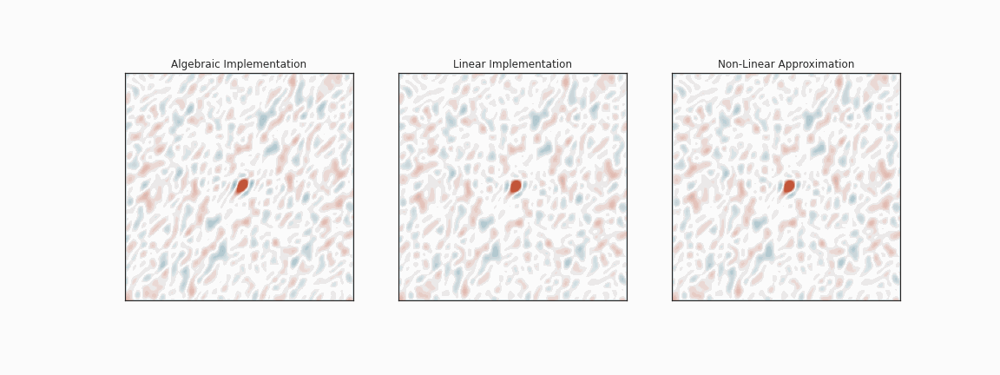

In [22]:
sims = [algebraic_sims, linear_sims, nonlinear_sims]
figsize = (16, 6)
titles = ['Algebraic Implementation', 'Linear Implementation', 'Non-Linear Approximation']

ani = heatmap_animation(sims, figsize, titles=titles)

HTML('<img src="data:image/gif;base64,{0}" />'.format(create_gif(ani)))

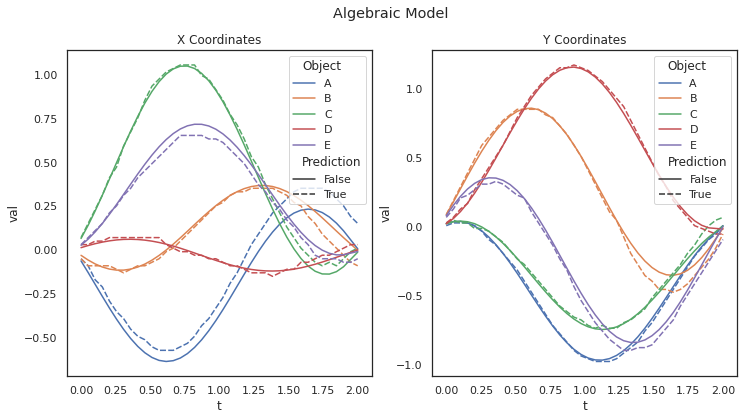

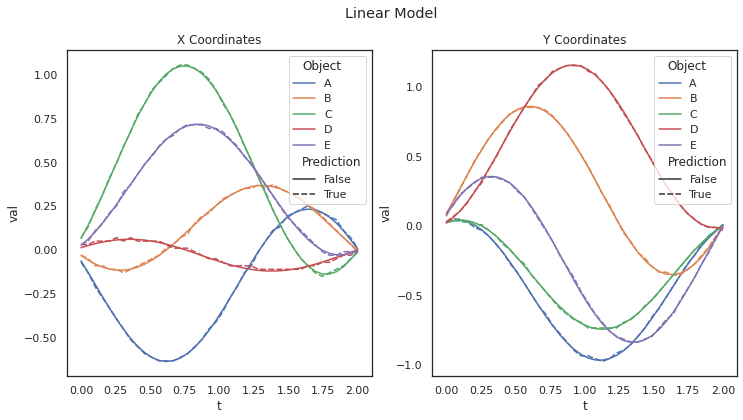

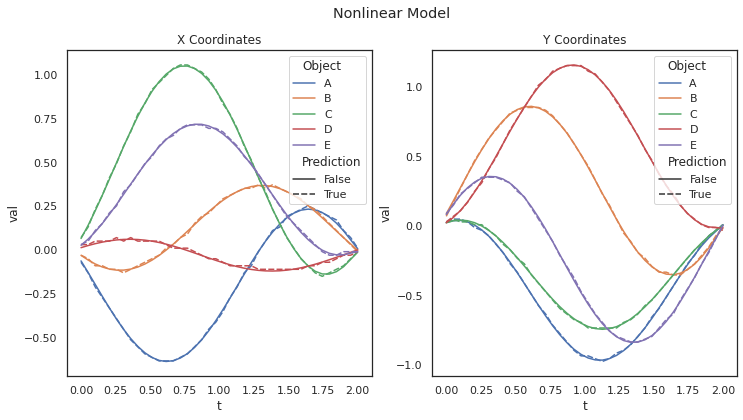

In [5]:
sns.set(style="white", palette="deep")

titles = ['Algebraic Model', 'Linear Model', 'Nonlinear Model']
logs = [algebraic_logs, linear_logs, nonlinear_logs]

for title, log in zip(titles, logs):
    plot_error(log, title)

### 2. Computing Mean Trajectory Errors

We can run multiple experiments with different initializations of the SSPs used to simulate the trajectory in question to get a sense of general tendencies observed using different simulation methods. Simulation is quite accurate using both a linear model and a simple multi-layer perceptron.

In [6]:
n_trials = 5
nonlinear_logs = TrajectoryLog(n_trials, trajectory)
linear_logs = TrajectoryLog(n_trials, trajectory)

# log over multiple trials to get error bars    
for trial in range(n_trials):
    ssp_map = Spatial2D(dim=dim, scale=scale,centered=True)
    ssp_map.build_grid(x_len, y_len, x_spaces, y_spaces)

    ssp = ssp_map.initialize_ssp(trajectory)

    xs, ys = create_data(
        ssp_map, [trajectory], add_noise=True, include_velocity=True)

    mlp = MLP(x_dim=2*dim, h_dims=2*dim, y_dim=dim)
    mlp.train(xs, ys, n_steps=n_epochs)

    linear = Linear(x_dim=2*dim, y_dim=dim)
    linear.train(xs, ys, n_steps=n_epochs)
    
    linear_sims = []
    nonlinear_sims = []

    for new_ssp in ssp_map.modelled_dynamics_gen_v2(trajectory, mlp):
        decoded = ssp_map.cleanup(new_ssp, trajectory.object_names)
        nonlinear_sims.append(ssp_map.compute_heatmap(decoded))
        nonlinear_logs.update(trial, ssp_map, new_ssp)
    
    for new_ssp in ssp_map.modelled_dynamics_gen_v2(trajectory, linear):
        decoded = ssp_map.cleanup(new_ssp, trajectory.object_names)
        linear_sims.append(ssp_map.compute_heatmap(decoded))
        linear_logs.update(trial, ssp_map, new_ssp)

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

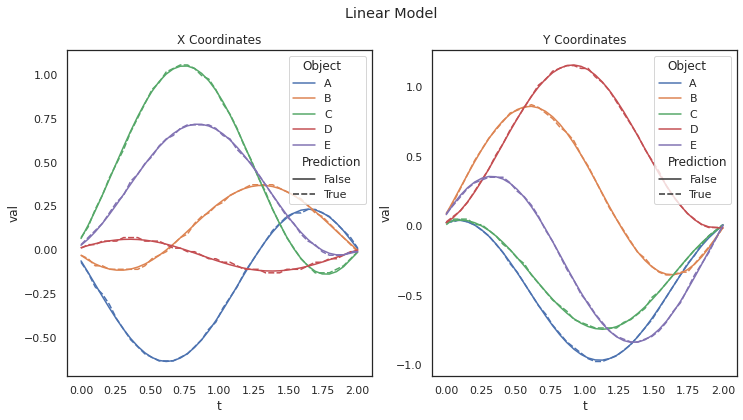

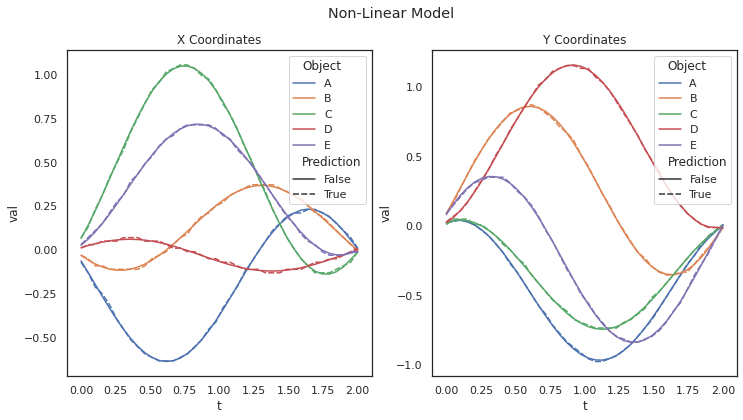

In [24]:
sns.set(style="white", palette="deep")
logs = [linear_logs, nonlinear_logs]
titles = ['Linear Model', 'Non-Linear Model']

for log, title in zip(logs, titles):
    plot_error(log, title)

### 3. Training on Multiple Trajectories



MovieWriter imagemagick unavailable; using Pillow instead.



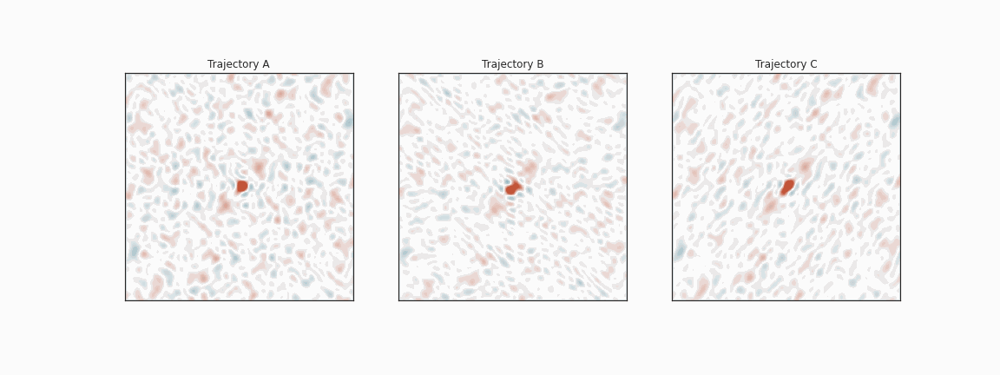

In [6]:
ssp_map = Spatial2D(dim=dim, scale=scale, decode_threshold=decode_threshold)
ssp_map.build_grid(x_len, y_len, x_spaces, y_spaces,centered=True)

trajset = [random_trajectory(ssp_map, t, dt, n_objects=5,noise=False,seed=i+1, rms=0.5,limit=0.2) for i in range(5)]

allsims = []
n = 3

# observe a couple of the trajectories to see what the variability is like
for trajectory in trajset[:n]:
    sims = []
    for new_ssp in ssp_map.algebraic_dynamics_gen(trajectory):
        decoded = ssp_map.cleanup(new_ssp, trajectory.object_names)
        sims.append(ssp_map.compute_heatmap(decoded))

    allsims.append(sims)
    
figsize = (16, 6)
titles = ['Trajectory A', 'Trajectory B', 'Trajectory C']

ani = heatmap_animation(allsims, figsize, titles=titles)

HTML('<img src="data:image/gif;base64,{0}" />'.format(create_gif(ani)))

In [7]:
# now try training on linear and non-linear approximators
xs, ys = create_data(
    ssp_map, trajset, add_noise=False, include_velocity=True)

mlp = MLP(x_dim=2*dim, h_dims=2*dim, y_dim=dim)
mlp.train(xs, ys, n_steps=n_epochs)

linear = Linear(x_dim=2*dim, y_dim=dim)
linear.train(xs, ys, n_steps=n_epochs)

linear_sims = []
nonlinear_sims = []

trajectory = np.random.choice(trajset)
nonlinear_logs = TrajectoryLog(1, trajectory)
linear_logs = TrajectoryLog(1, trajectory)

ssp = ssp_map.initialize_ssp(trajectory)

for new_ssp in ssp_map.modelled_dynamics_gen_v2(trajectory, mlp):
    decoded = ssp_map.cleanup(new_ssp, trajectory.object_names)
    nonlinear_sims.append(ssp_map.compute_heatmap(decoded))
    nonlinear_logs.update(0, ssp_map, new_ssp)

for new_ssp in ssp_map.modelled_dynamics_gen_v2(trajectory, linear):
    decoded = ssp_map.cleanup(new_ssp, trajectory.object_names)
    linear_sims.append(ssp_map.compute_heatmap(decoded))
    linear_logs.update(0, ssp_map, new_ssp)

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

MovieWriter imagemagick unavailable; using Pillow instead.



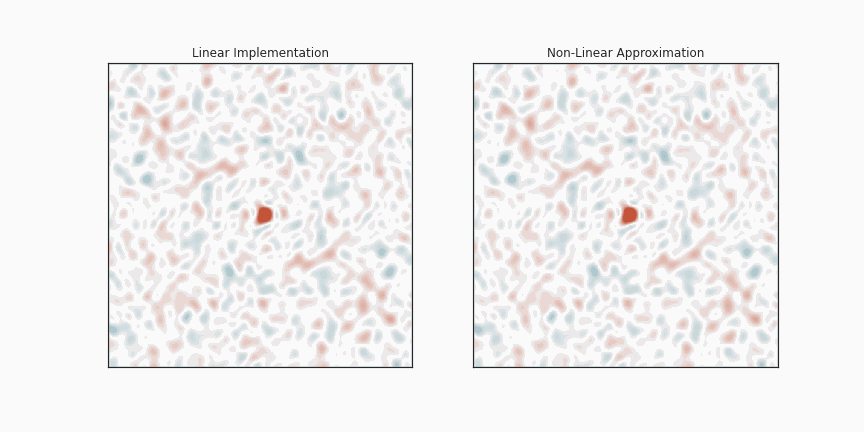

In [27]:
sims = [linear_sims, nonlinear_sims]
figsize = (12, 6)
titles = ['Linear Implementation', 'Non-Linear Approximation']

ani = heatmap_animation(sims, figsize, titles=titles)

HTML('<img src="data:image/gif;base64,{0}" />'.format(create_gif(ani)))

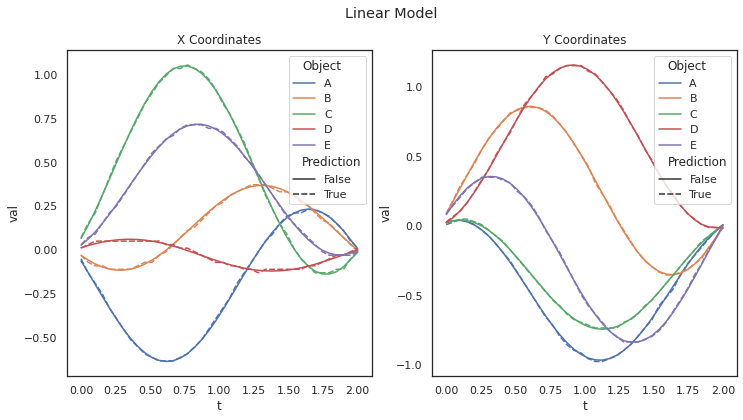

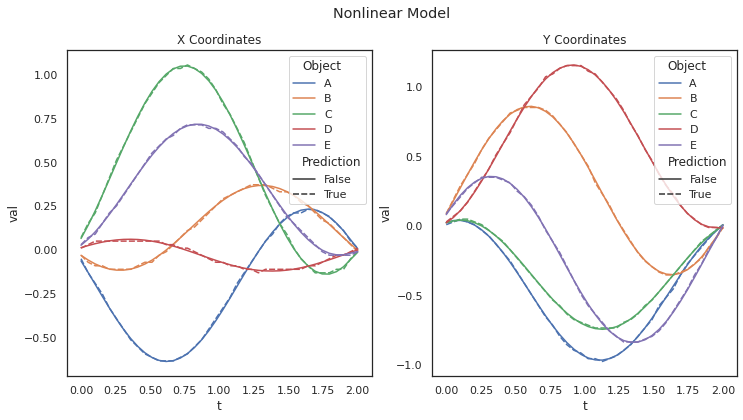

In [8]:
titles = ['Linear Model', 'Nonlinear Model']
logs = [linear_logs, nonlinear_logs]

for title, log in zip(titles, logs):
    plot_error(log, title)

Let's try a test example

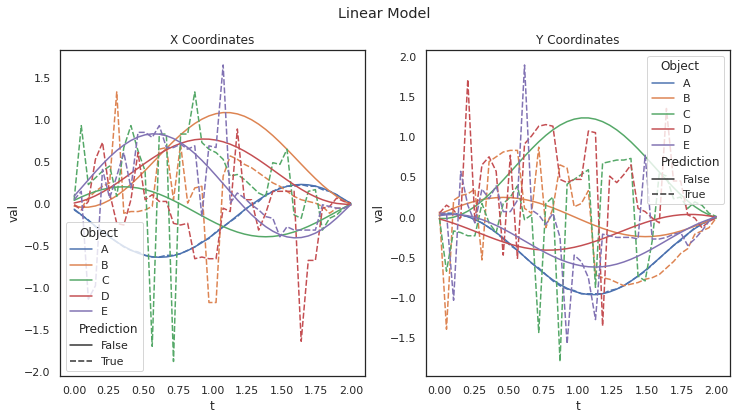

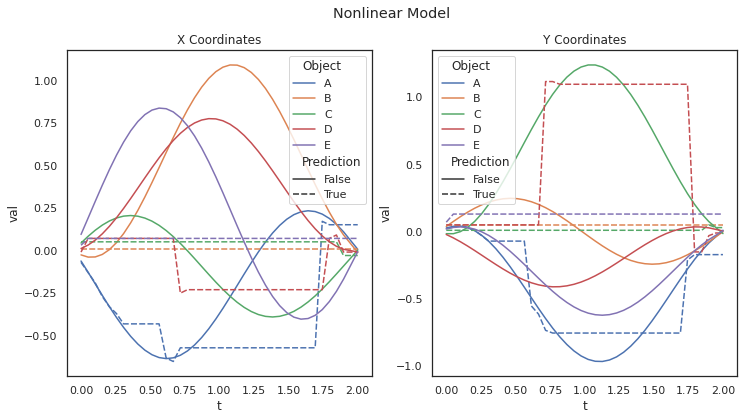

In [9]:
trajectory = random_trajectory(ssp_map, t, dt, n_objects=5,noise=False,seed=10, rms=0.5,limit=0.2)
nonlinear_logs = TrajectoryLog(1, trajectory)
linear_logs = TrajectoryLog(1, trajectory)

ssp = ssp_map.initialize_ssp(trajectory)

for new_ssp in ssp_map.modelled_dynamics_gen_v2(trajectory, mlp):
    nonlinear_logs.update(0, ssp_map, new_ssp)

for new_ssp in ssp_map.modelled_dynamics_gen_v2(trajectory, linear):
    linear_logs.update(0, ssp_map, new_ssp)
    
titles = ['Linear Model', 'Nonlinear Model']
logs = [linear_logs, nonlinear_logs]

for title, log in zip(titles, logs):
    plot_error(log, title)

What about with more training? & more neurons in MLP

In [10]:
n_epochs = 5000
trajset = [random_trajectory(ssp_map, t, dt, n_objects=5,noise=False,seed=i+1, rms=0.5,limit=0.2) 
           for i in range(50)]
xs, ys = create_data(
    ssp_map, trajset, add_noise=False, include_velocity=True)

mlp = MLP(x_dim=2*dim, h_dims=5*dim, y_dim=dim)
mlp.train(xs, ys, n_steps=n_epochs)

linear = Linear(x_dim=2*dim, y_dim=dim)
linear.train(xs, ys, n_steps=n_epochs)



HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

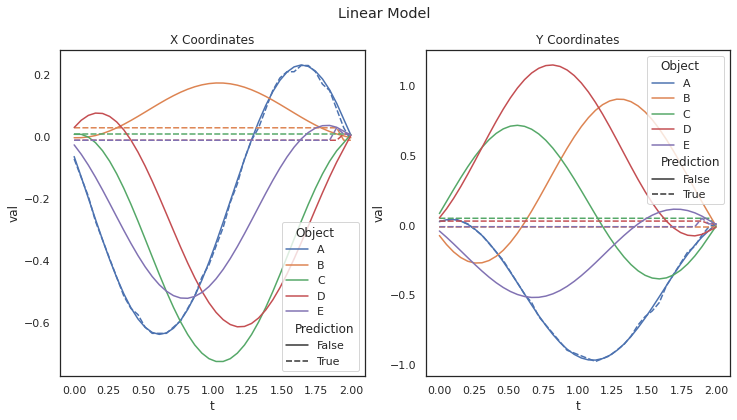

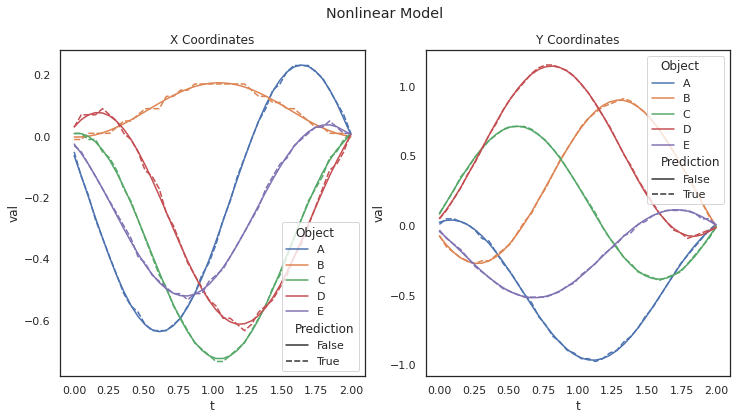

In [11]:
linear_sims = []
nonlinear_sims = []

trajectory = np.random.choice(trajset)
nonlinear_logs = TrajectoryLog(1, trajectory)
linear_logs = TrajectoryLog(1, trajectory)

ssp = ssp_map.initialize_ssp(trajectory)

for new_ssp in ssp_map.modelled_dynamics_gen_v2(trajectory, mlp):
    nonlinear_logs.update(0, ssp_map, new_ssp)

for new_ssp in ssp_map.modelled_dynamics_gen_v2(trajectory, linear):
    linear_logs.update(0, ssp_map, new_ssp)

titles = ['Linear Model', 'Nonlinear Model']
logs = [linear_logs, nonlinear_logs]

for title, log in zip(titles, logs):
    plot_error(log, title)

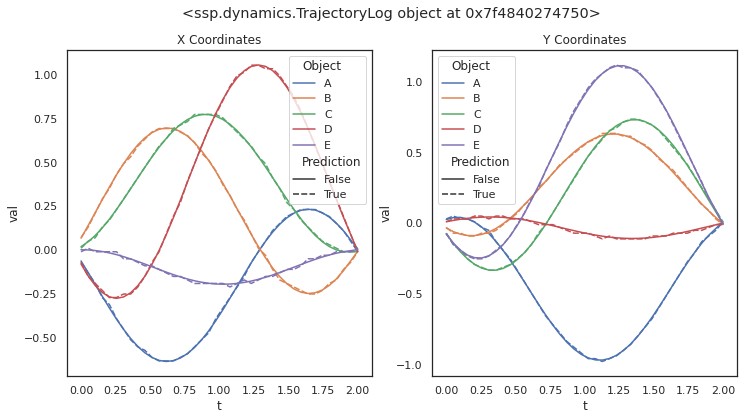

In [12]:
trajectory = random_trajectory(ssp_map, t, dt, n_objects=5,noise=False,seed=100, rms=0.5,limit=0.2)

trajectory = np.random.choice(trajset)
nonlinear_logs = TrajectoryLog(1, trajectory)

ssp = ssp_map.initialize_ssp(trajectory)

for new_ssp in ssp_map.modelled_dynamics_gen_v2(trajectory, mlp):
    nonlinear_logs.update(0, ssp_map, new_ssp)

plot_error(nonlinear_logs, nonlinear_logs)

What if clean-ups were done with the learned models?

In [227]:
from ssp.models import Model
import tensorflow as tf
from nengo.utils.numpy import array

class CleanUpLayer(tf.keras.layers.Layer):
    def __init__(self, ssp_map):
        super(CleanUpLayer, self).__init__()
        self.dim = ssp_map.dim
        self.ssp_map = ssp_map
        self.ssp_tensor = tf.convert_to_tensor(ssp_map.ssp_tensor,dtype='float64')
        self.num_outputs = ssp_map.dim
        

    def build(self, input_shape):
        return

    def call(self, input):      
        sims = tf.tensordot(self.ssp_tensor,input, axes=([2], [1]))
        #inds = tf.unravel_index(tf.math.argmax(tf.reshape(sims,[-1, input.shape[0]])), sims.shape[0:2])
        #return tf.gather_nd(self.ssp_tensor, tf.transpose(inds))
        return tf.tensordot(tf.nn.softmax(sims),ssp_map.ssp_tensor, axes = [[0,1],[0,1]])

class MLPCleanBlock(tf.keras.Model):
    def __init__(self, ssp_map, x_dim, h_dims, y_dim):
        super(MLPCleanBlock, self).__init__(name='')
        h_dims = array(h_dims, min_dims=1)
        self.denseblock = tf.keras.models.Sequential(
                [tf.keras.layers.Dense(h_dims[0], "relu", input_shape=(x_dim,)),]
                + [tf.keras.layers.Dense(h_dims[i], "relu") for i in range(1, len(h_dims))]
                + [tf.keras.layers.Dense(y_dim),]
        )
        self.cleanup = CleanUpLayer(ssp_map)

    def call(self, input_tensor, training=True):
        res = self.denseblock(input_tensor)
        res = self.cleanup(res)
        return res

    
    
class MLP_cleanup(Model):

    def __init__(self, ssp_map, x_dim, h_dims, y_dim):
        super().__init__()
        
        assert ssp_map.dim == y_dim
        
        
        self.model = MLPCleanBlock(ssp_map, x_dim, h_dims, y_dim)
        # Below doesn't work :/
      #  self.model = tf.keras.models.Sequential(
       #     [tf.keras.layers.Dense(h_dims[0], "relu", input_shape=(x_dim,)),]
        #    + [tf.keras.layers.Dense(h_dims[i], "relu") for i in range(1, len(h_dims))]
         #   + [tf.keras.layers.Dense(y_dim),]
          #  + [cl]
        #)


In [ ]:
trajset = [random_trajectory(ssp_map, t, dt, n_objects=5,noise=False,seed=i+1, rms=0.5,limit=0.2) 
           for i in range(5)]
xs, ys = create_data(
    ssp_map, trajset, add_noise=False, include_velocity=True)

mlp = MLP_cleanup(ssp_map,x_dim=2*dim, h_dims=2*dim, y_dim=dim)

mlp.train(xs, ys, n_steps=n_epochs)

In [18]:
# Let's try doing a clean-up after 
def modelled_dynamics_gen_v2_2(ssp_map, trajectory, model, names, top_only=True, average=False):
    """Simulate dynamics for multiple distinct objects with SSP velocity"""
    ssp = ssp_map.initialize_ssp(trajectory)
    x = np.zeros(len(names))
    y = np.zeros(len(names))
    for i, t in enumerate(trajectory.timesteps):
        vx = [spec.vx[i] * trajectory.dt for spec in trajectory.object_specs]
        vy = [spec.vy[i] * trajectory.dt for spec in trajectory.object_specs]
        vssp = ssp_map.encode_points(vx, vy, names=trajectory.object_names)
        out = model(np.hstack([ssp.v, vssp.v]))
        ssp = spa.SemanticPointer(out)
        decoded = ssp_map.voc["Zero"]
        for name in range(len(names)):
            coords = ssp_map.decode_ssp_coords(ssp, names[name], ssp_map, average)
            if coords is not None:
                x[name], y[name] = coords
            decoded += ssp_map.encode_point(x[name], y[name]) *  ssp_map.voc[names[name]]          
            
        yield decoded

In [19]:
dim = 512

t=10
dt=0.05
x_len=2
y_len =2
scale=5
x_spaces=200
y_spaces=200

ssp_map = Spatial2D(dim=dim, scale=scale, decode_threshold=decode_threshold)
ssp_map.decode_threshold = 0.4
ssp_map.build_grid(x_len, y_len, x_spaces, y_spaces,centered=True)

trajset = [random_trajectory(ssp_map, t, dt, n_objects=5,noise=False,seed=i+1, rms=0.5,limit=0.2) for i in range(5)]
trajset_val = [random_trajectory(ssp_map, t, dt, n_objects=5,noise=False,seed=10+i+1, rms=0.5,limit=0.2) for i in range(2)]



# now try training on linear and non-linear approximators

xs, ys = create_data(
    ssp_map, trajset, add_noise=False, include_velocity=True)

n_epochs=300
mlp = MLP(x_dim=2*dim, h_dims=5*dim, y_dim=dim)
mlp.train(xs, ys, n_steps=n_epochs)




HtmlProgressBar cannot be displayed. Please use the TerminalProgressBar. It can be enabled with `nengo.rc['progress']['progress_bar'] = 'nengo.utils.progress.TerminalProgressBar'`.

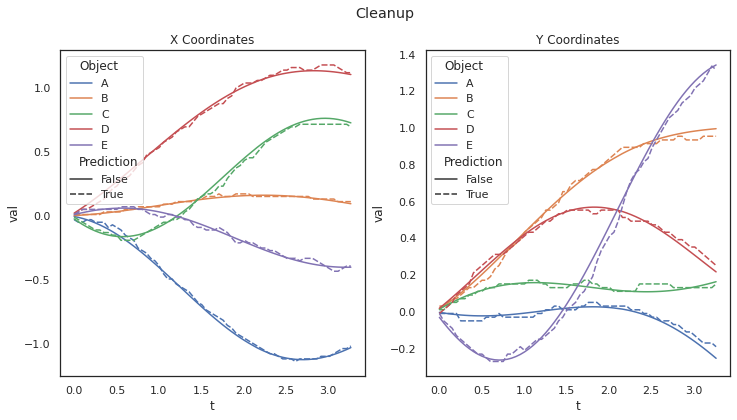

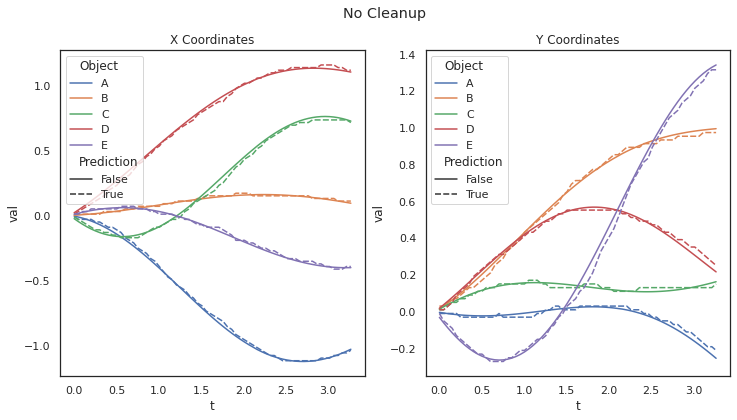

In [20]:


trajectory = np.random.choice(trajset)
trajectory.timesteps=trajectory.timesteps[0:len(trajectory.timesteps)//3]
cleanup_logs = TrajectoryLog(1, trajectory)
nocleanup_logs = TrajectoryLog(1, trajectory)

ssp = ssp_map.initialize_ssp(trajectory)

for new_ssp in modelled_dynamics_gen_v2_2(ssp_map,trajectory, mlp, trajectory.object_names):
    cleanup_logs.update(0, ssp_map, new_ssp)

for new_ssp in ssp_map.modelled_dynamics_gen_v2(trajectory, mlp):
    nocleanup_logs.update(0, ssp_map, new_ssp)

ssp = ssp_map.initialize_ssp(trajectory)


titles = ['Cleanup', 'No Cleanup']
logs = [cleanup_logs, nocleanup_logs]

for title, log in zip(titles, logs):
    plot_error(log, title)

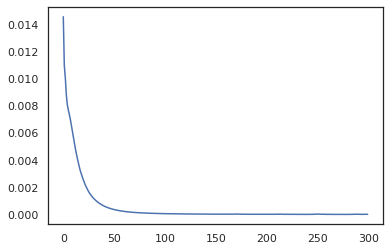

In [21]:
plt.figure()
plt.plot(np.array([v.numpy() for v in mlp.costs]))

In [22]:
cleanup_logs.global_error

0.18590307982917326

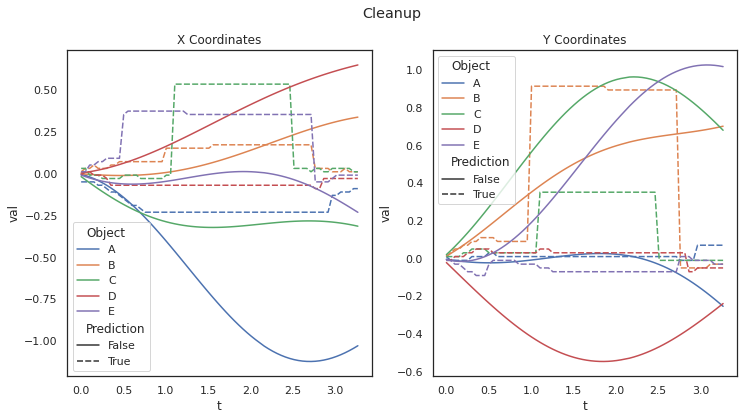

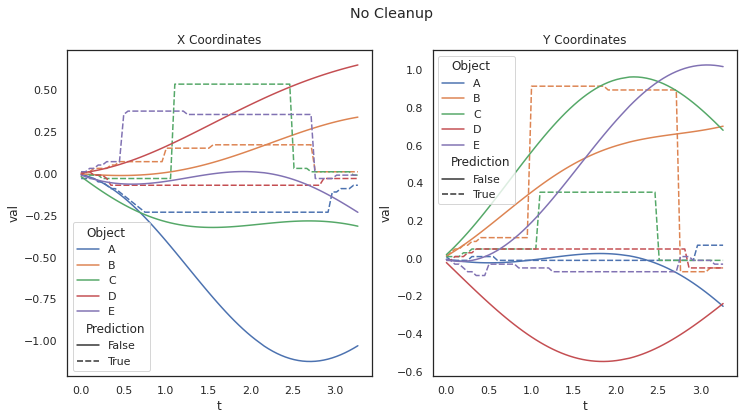

In [23]:


trajectory = np.random.choice(trajset_val)
trajectory.timesteps=trajectory.timesteps[0:len(trajectory.timesteps)//3]
cleanup_logs = TrajectoryLog(1, trajectory)
nocleanup_logs = TrajectoryLog(1, trajectory)

ssp = ssp_map.initialize_ssp(trajectory)

for new_ssp in modelled_dynamics_gen_v2_2(ssp_map,trajectory, mlp, trajectory.object_names):
    cleanup_logs.update(0, ssp_map, new_ssp)

for new_ssp in ssp_map.modelled_dynamics_gen_v2(trajectory, mlp):
    nocleanup_logs.update(0, ssp_map, new_ssp)

ssp = ssp_map.initialize_ssp(trajectory)


titles = ['Cleanup', 'No Cleanup']
logs = [cleanup_logs, nocleanup_logs]

for title, log in zip(titles, logs):
    plot_error(log, title)

Multiple trajectories often doesn't work well because the ML system is expected to learn how to resolve ambiguities between trajectories that overlap in space with different velocities (the ML models are not given any input beyond the current SSP). That is an impossible task.

### 4. Performing Method Comparisons

Now we'll compare model generalization by test RMSE across a number of methods: (a) algebraic SSP manipulation, (b) linear approximation, (c) non-linear approximation, (d) linear approximation with noise augmentation, and (e) non-linear approximation with noise augmentation. We do so training on 100 trajectories and testing on 50 trajectories.

In [15]:
n_trials = 1
dim_samples = []
obj_samples = []
n_epochs = 1000

def run_trial(dim, n_objects, sample_list,
              n_train=100, n_test=50, n_epochs=n_epochs):
    # initialize map and train the models
    t=10
    dt=0.05
    x_len=2
    y_len =2
    scale=5
    x_spaces=200
    y_spaces=200
    ssp_map = Spatial2D(dim=dim, scale=scale, decode_threshold=0.4)
    #ssp_map.decode_threshold = 0.4
    ssp_map.build_grid(x_len, y_len, x_spaces, y_spaces,centered=True)

    # build trajectories
    all_trajectories = []
    for n in range(n_train + n_test):
        traj = random_trajectory(ssp_map, t, dt, n_objects=n_objects, noise=False,seed=n+1, rms=0.5,limit=0.2)
        all_trajectories.append(traj)

    train_trajectories = all_trajectories[:n_train]
    test_trajectories=[]
    for t in all_trajectories[n_train:]:
        traj = t
        traj.timesteps=traj.timesteps[0:len(traj.timesteps)//3]
        traj.t = traj.timesteps[-1]
        test_trajectories.append(traj)

    # approximation without noise augmentation
    xs, ys = create_data(
        ssp_map, train_trajectories, add_noise=False, include_velocity=True)

    mlp = MLP(x_dim=2*dim, h_dims=4*dim, y_dim=dim)
    mlp.train(xs, ys, n_steps=n_epochs)

    linear = Linear(x_dim=2*dim, y_dim=dim)
    linear.train(xs, ys, n_steps=n_epochs)


    for test_trajectory in test_trajectories:
        # setup logging
        alg_log = TrajectoryLog(1, test_trajectory)
        lin_log = TrajectoryLog(1, test_trajectory)
        mlp_log = TrajectoryLog(1, test_trajectory)

        # algebraic method
        for new_ssp in ssp_map.algebraic_dynamics_gen(test_trajectory):
            alg_log.update(0, ssp_map, new_ssp)

        # ML methods
        for new_ssp in modelled_dynamics_gen_v2_2(ssp_map,test_trajectory, linear,test_trajectory.object_names):
            decoded = ssp_map.cleanup(new_ssp, trajectory.object_names)
            lin_log.update(0, ssp_map, new_ssp)

        for new_ssp in modelled_dynamics_gen_v2_2(ssp_map,test_trajectory, mlp,test_trajectory.object_names):
            mlp_log.update(0, ssp_map, new_ssp)


        # create data samples to use for plotting
        sample_list.append(
            {'Method': 'Algebraic',
             'RMSE': alg_log.global_error,
             'N Objects': n_objects,
             'D': dim})
        sample_list.append(
            {'Method': 'Linear',
             'RMSE': lin_log.global_error,
             'N Objects': n_objects,
             'D': dim})
        sample_list.append(
            {'Method': 'MLP',
             'RMSE': mlp_log.global_error,
             'N Objects': n_objects,
             'D': dim})

    #return all_trajectories


In [ ]:
        
# collect data for two experiments
for n_objects in (2, 3, 4, 5):
    for trial in range(n_trials):
        run_trial(512, n_objects, obj_samples)
        
for dim in [256, 512, 1024]:
    for trial in range(n_trials):
        run_trial(dim, 5, dim_samples)

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

sns.barplot(x="Method", y="RMSE", hue="N Objects", data=pd.DataFrame(obj_samples), ax=ax1)
sns.barplot(x="Method", y="RMSE", hue="D", data=pd.DataFrame(dim_samples), ax=ax2)


ax1.set_title('SSP Dimensionality of 512')
ax2.set_title('5 Objects In Trajectory')
# plt.suptitle('Training on 10 Sample Trajectories')
plt.savefig('multi_obj_benchmark_v4.png')
plt.savefig('multi_obj_benchmark_v4.pdf')

### 4. Algebraic method in network


In [25]:
import torch # need torch 1.7 for this
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torch.utils.data import Dataset, TensorDataset


In [37]:
def circular_conv(X,Y):
    fX = torch.rfft(X,signal_ndim=1,onesided=False)
    fY = torch.rfft(Y,signal_ndim=1,onesided=False)
    real1  = fX[:,0]
    imag1= fX[:,1]
    real2  = fY[:,0]
    imag2= fY[:,1]
    fXY = torch.stack([real1 * real2 - imag1 * imag2, real1 * imag2 + imag1 * real2], dim = -1)

    
    return torch.irfft(fXY,signal_ndim=1,onesided=False)


def frac_bind(X,x):
    fX = torch.view_as_complex(torch.rfft(X,signal_ndim=1,onesided=False))
    fXx = torch.view_as_real(torch.pow(fX,x))

    return torch.irfft(fXx,signal_ndim=1,onesided=False)



class AlgrebraicModel(nn.Module):
    def __init__(self, ssp_map, object_names):
        super().__init__()
        dim = ssp_map.dim
        self.n_objects = len(object_names)
        self.ssp_map = ssp_map
        self.alg = spa.algebras.HrrAlgebra()
        object_sps = np.zeros((self.n_objects,dim))
        object_isps = np.zeros((self.n_objects,dim))
        object_sp_mat = np.zeros((self.n_objects,dim,dim))
        object_sp_imat = np.zeros((self.n_objects,dim,dim))
        for i in range(self.n_objects):
            object_sps[i,:] = ssp_map.voc[object_names[i]].v
            object_isps[i,:] = (~ssp_map.voc[object_names[i]]).v
            object_sp_mat[i,:,:] = self.alg.get_binding_matrix((ssp_map.voc[object_names[i]]).v)
            object_sp_imat[i,:,:] = self.alg.get_binding_matrix((~ssp_map.voc[object_names[i]]).v)
        self.object_sp_mat = torch.Tensor(object_sp_mat)
        self.object_sp_imat = torch.Tensor(object_sp_imat)
        self.object_sps = torch.Tensor(object_sps)
        self.object_isps = torch.Tensor(object_isps)
        self.ssp_tensor = torch.Tensor(self.ssp_map.ssp_tensor)
        self.X = torch.Tensor(ssp_map.X.v)
        self.Y=torch.Tensor(ssp_map.Y.v)
        self.zero = torch.Tensor(ssp_map.voc["Zero"].v)
        self.fX = torch.view_as_complex(torch.rfft(self.X,signal_ndim=1,onesided=False))
        self.fY = torch.view_as_complex(torch.rfft(self.Y,signal_ndim=1,onesided=False))
        self.xs = torch.Tensor(ssp_map.xs)
        self.ys = torch.Tensor(ssp_map.ys)
        self.scale = ssp_map.scale
        
    def encode_point(self,x,y):
        fS = torch.view_as_real(torch.pow(self.fX,x*self.scale) * torch.pow(self.fY,y*self.scale))
        return  torch.irfft(fS,signal_ndim=1,onesided=False)
    
    def cleanup_name(self, ssp, i):
        #obj_ssp = self.object_sp_imat[i,:,:] @ ssp
        obj_ssp = circular_conv(ssp, self.object_isps[i,:])
        sims = torch.tensordot(self.ssp_tensor, obj_ssp, dims=([2], [0]))
        inds = self.unravel_index(sims.argmax(), list(sims.shape))
        clean_obj_ssp = self.ssp_tensor[inds[0], inds[1],:]
        return clean_obj_ssp
    
    def cleanup(self, ssp):
        sims = torch.tensordot(self.ssp_tensor, ssp, dims=([2], [0]))
        inds = self.unravel_index(sims.argmax(), list(sims.shape))
        clean_ssp = self.ssp_tensor[inds[0], inds[1],:]
        return clean_ssp
    
    def unravel_index(self, index, shape):
        out = []
        for dim in reversed(shape):
            out.append(index % dim)
            index = index // dim
        return tuple(reversed(out))
        
    def forward(self,ssp,vssp):
        new_ssp = self.zero
        for i in range(self.n_objects):
            clean_obj_ssp = self.cleanup_name(ssp,i)
            clean_vssp = self.cleanup_name(vssp,i)
            new_obj_ssp = circular_conv(clean_obj_ssp,clean_vssp)
            #new_ssp += self.object_sp_mat[i,:,:] @ new_obj_ssp
            new_ssp += circular_conv(new_obj_ssp - clean_obj_ssp, self.object_sps[i,:])
        return new_ssp
    
def run_alg_model(ssp_map,model,trajectory):
    ssp = ssp_map.initialize_ssp(trajectory)
    for i, t in enumerate(trajectory.timesteps):
        vx = [spec.vx[i] * trajectory.dt for spec in trajectory.object_specs]
        vy = [spec.vy[i] * trajectory.dt for spec in trajectory.object_specs]
        vssp = ssp_map.encode_points(vx, vy, names=trajectory.object_names)
        out = model(torch.Tensor(ssp.v), torch.Tensor(vssp.v)).numpy()
        ssp = spa.SemanticPointer(out)
        yield ssp
        


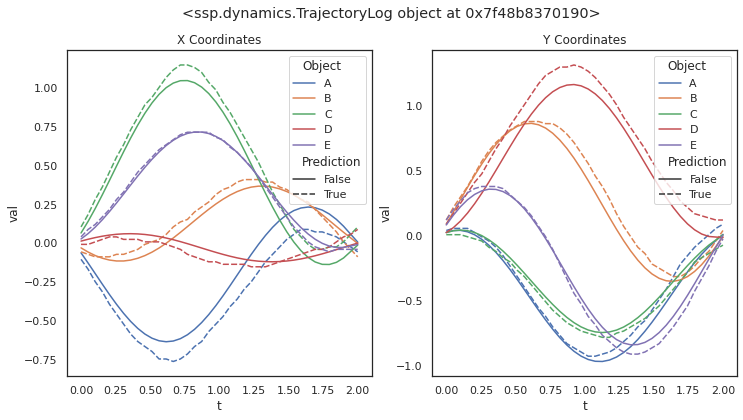

In [38]:
dim = 512
scale = 10

t = 2
dt = 0.05

x_len = 1.6
y_len = 1.6
x_spaces = 200
y_spaces = 200
decode_threshold = 0.35

n_epochs = 1000

ssp_map = Spatial2D(dim=dim, scale=scale, decode_threshold=decode_threshold)
ssp_map.build_grid(x_len, y_len, x_spaces, y_spaces,centered=True)

trajectory = random_trajectory(ssp_map, t, dt, n_objects=n_objects,noise=False,seed=1, rms=0.5,limit=0.2) 
model = AlgrebraicModel(ssp_map, trajectory.object_names)

alg_logs = TrajectoryLog(1, trajectory)
for new_ssp in run_alg_model(ssp_map,model,trajectory):
    alg_logs.update(0, ssp_map, new_ssp)

plot_error(alg_logs, alg_logs)

In [48]:
ssp_map.dim

512

In [47]:
train_x.shape

torch.Size([21000, 512])

In [49]:
def make_train_step(model, loss_fn, optimizer):
    def train_step(x, y):
        model.train()
        yhat = model(x)
        loss = loss_fn(y, yhat)
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        return loss.item()
    
    return train_step

class CleanUpModel(nn.Module):
    def __init__(self, ssp_map):
        super().__init__()
        dim = ssp_map.dim
        self.ssp_map = ssp_map
        self.alg = spa.algebras.HrrAlgebra()
        
        self.layers = nn.Sequential(
          nn.Linear(dim*2, dim*2),
          nn.ReLU(),
          nn.Linear(dim*2,dim),
        )
        
    def forward(self, ssp):
        return self.layers(ssp)
    
    def get_train_examples(self, n_train, object_names):
        n_objects = len(object_names)
        n_train = int(n_train//n_objects)
        train_x_coords = np.random.randint(0, self.ssp_map.ssp_tensor.shape[0], n_train*n_objects)
        train_y_coords = np.random.randint(0, self.ssp_map.ssp_tensor.shape[1], n_train*n_objects)
        
        object_sp_mat = np.zeros((n_objects,dim,dim))
        object_sp_imat = np.zeros((n_objects,dim,dim))
        for i in range(n_objects):
            object_sp_mat[i,:,:] = self.alg.get_binding_matrix((self.ssp_map.voc[object_names[i]]).v)
            object_sp_imat[i,:,:] = self.alg.get_binding_matrix((~self.ssp_map.voc[object_names[i]]).v)
        
        ssp_samples = self.ssp_map.ssp_tensor[train_x_coords, train_y_coords, :]
        train_M = np.zeros((n_train,dim))
        for i in range(n_objects):
            for j in range(n_train):
                train_M[j,:] += object_sp_mat[i,:,:] @ ssp_samples[i*n_train + j,:]
        
        train_x = np.zeros((n_objects,n_train,dim*2))
        train_y = np.zeros((n_objects,n_train,dim))
        for i in range(n_objects):
            for j in range(n_train):
                train_x[i,j,:] = np.concatenate((object_sp_imat[i,:,:] @ train_M[j,:], (self.ssp_map.voc[object_names[i]]).v))
                train_y[i,j,:] = ssp_samples[i*n_train + j,:]
        return (torch.Tensor(train_x.reshape(-1,dim*2)), torch.Tensor(train_y.reshape(-1,dim)))
    
cleanup_model = CleanUpModel(ssp_map)
n_train = 10000
n_test = 500
train_x, train_y = cleanup_model.get_train_examples(n_train+n_test, trajectory.object_names)

lr = 1e-1
n_epochs = 1000

loss_fn = nn.MSELoss(reduction='mean')
optimizer = torch.optim.SGD(cleanup_model.parameters(), lr=lr)

train_data = TensorDataset(train_x[0:n_train,:], train_y[0:n_train,:])
train_loader = DataLoader(dataset=train_data, batch_size=128, shuffle=True)
    
losses = []
train_step = make_train_step(cleanup_model, loss_fn, optimizer)

for epoch in range(n_epochs):
    for x_batch, y_batch in train_loader:

        
        loss = train_step(x_batch, y_batch)
        losses.append(loss)

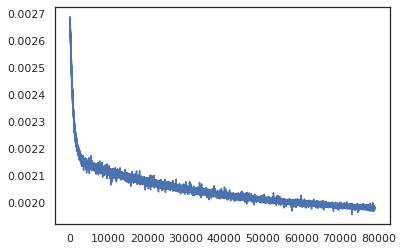

In [50]:
plt.figure()
plt.plot(losses)

In [ ]:
class AlgrebraicModel2(nn.Module):
    def __init__(self, ssp_map, cleanup_model, object_names):
        super().__init__()
        dim = ssp_map.dim
        self.n_objects = len(object_names)
        self.ssp_map = ssp_map
        self.cleanup_model = cleanup_model
        self.alg = spa.algebras.HrrAlgebra()
        object_sps = np.zeros((self.n_objects,dim))
        object_isps = np.zeros((self.n_objects,dim))
        object_sp_mat = []
        object_sp_imat = []
        
        self.unbind_layers = []
        self.bind_layers = []
        for i in range(self.n_objects):
            object_sps[i,:] = ssp_map.voc[object_names[i]].v
            object_isps[i,:] = (~ssp_map.voc[object_names[i]]).v
            object_sp_mat.append(torch.nn.parameter.Parameter(torch.from_numpy(self.alg.get_binding_matrix((ssp_map.voc[object_names[i]]).v)).float(), 
                                                                requires_grad=False))
            object_sp_imat.append(torch.nn.parameter.Parameter(torch.from_numpy(self.alg.get_binding_matrix((~ssp_map.voc[object_names[i]]).v)).float(),
                                                              requires_grad=False))
            
            self.bind_layers.append(torch.nn.Linear(dim,dim,bias=False))
            self.bind_layers[-1].weight = object_sp_mat[-1]
            self.unbind_layers.append(torch.nn.Linear(dim,dim,bias=False))
            self.unbind_layers[-1].weight = object_sp_imat[-1]
            
 
        self.object_sps = torch.Tensor(object_sps)
        self.object_isps = torch.Tensor(object_isps)
        self.ssp_tensor = torch.Tensor(self.ssp_map.ssp_tensor)
        self.X = torch.Tensor(ssp_map.X.v)
        self.Y=torch.Tensor(ssp_map.Y.v)
        self.zero = torch.Tensor(ssp_map.voc["Zero"].v)
        self.fX = torch.view_as_complex(torch.rfft(self.X,signal_ndim=1,onesided=False))
        self.fY = torch.view_as_complex(torch.rfft(self.Y,signal_ndim=1,onesided=False))
        self.xs = torch.Tensor(ssp_map.xs)
        self.ys = torch.Tensor(ssp_map.ys)
        self.scale = ssp_map.scale
        

        
    def encode_point(self,x,y):
        fS = torch.view_as_real(torch.pow(self.fX,x*self.scale) * torch.pow(self.fY,y*self.scale))
        return  torch.irfft(fS,signal_ndim=1,onesided=False)
    
    def cleanup_name(self, ssp, i):
        obj_ssp = self.unbind_layers[i](ssp) 
        clean_obj_ssp = self.cleanup_model(obj_ssp)
        return clean_obj_ssp
    
    def unravel_index(self, index, shape):
        out = []
        for dim in reversed(shape):
            out.append(index % dim)
            index = index // dim
        return tuple(reversed(out))
        
    def forward(self,ssp,vssp):
        new_ssp = self.zero
        for i in range(self.n_objects):
            clean_obj_ssp = self.cleanup_name(ssp,i)
            clean_vssp = self.cleanup_name(vssp,i)
            new_obj_ssp = circular_conv(clean_obj_ssp,clean_vssp)
            #new_ssp += self.object_sp_mat[i,:,:] @ new_obj_ssp
            new_ssp += self.bind_layers[i](new_obj_ssp - clean_obj_ssp)#circular_conv(new_obj_ssp - clean_obj_ssp, self.object_sps[i,:])
        return new_ssp
    
